# 1. Introduction

Name: Celine Clarissa

Original Dataset: [Kaggle](https://www.kaggle.com/datasets/athu1105/book-genre-prediction/data).

Deployment: [Hugging Face](https://huggingface.co/spaces/celineclarissa/GC7)

GitHub: [GitHub Link](https://github.com/celineclarissa/Book-Genre-Prediction)

---

## Identifying the Problem

#### `Background`

I am a data scientist at a book distribution company. As a company, it is important to know the characteristics of books in order to sort books based on its genre. The information can then be used to make strategies based on book genre.

#### `Problem Statement and Objectives (SMART Framework)`
 
As a data scientist at a book distribution company, skills of training, testing, tuning, and evaluating a model are important because the company can then use the model to predict the genre of a book before accepting to distribute it. The company can then determine a business strategy like planning a choosing books to distribute based on genre, for example. This can be done by using data. After analyzing book genre characteristics from EDA, data scientist will then do feature engineering towards data. Then, data scientist will do modelling with ANN to predict genre of book. Then, data scientist will attempt to improve model. The best model is aimed to have an accuracy score of more than 90% and then deployed on HuggingFace for effective use after 7 working days. Webapp where model is deployed will also feature a page for EDA.

---
---

# 2. Import Libraries

In [1]:
# import libraries
import pandas as pd
import re

# import EDA
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from wordcloud import WordCloud

# import feature engineering
from sklearn.model_selection import train_test_split
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import tensorflow as tf
import tensorflow_hub as tf_hub
from tensorflow.keras.utils import to_categorical
import warnings
warnings.filterwarnings('ignore')

# import model
from sklearn.feature_extraction.text import CountVectorizer
from tensorflow.keras.layers import TextVectorization
from tensorflow.keras.layers import Embedding
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, GRU, Dropout, Reshape

# import evaluation
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

# import model saving & inference
import pickle
from tensorflow.keras.models import load_model
from google.colab import files

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


---
---

# 3. Data Loading

Data contains information regarding book titles, summary, and genre.

Data was obtained from [kaggle.com](https://www.kaggle.com/datasets/athu1105/book-genre-prediction/data).

In [2]:
! kaggle datasets download athu1105/book-genre-prediction

Dataset URL: https://www.kaggle.com/datasets/athu1105/book-genre-prediction
License(s): CC0-1.0
100% 3.73M/3.73M [00:00<00:00, 5.79MB/s]
100% 3.73M/3.73M [00:00<00:00, 4.24MB/s]


In [3]:
! unzip book-genre-prediction.zip

Archive:  book-genre-prediction.zip
  inflating: data.csv                


In [4]:
# load data
df_ori = pd.read_csv('data.csv')
df_ori

,index,title,genre,summary
0,0,Drowned Wednesday,fantasy,Drowned Wednesday is the first Trustee among ...
1,1,The Lost Hero,fantasy,"As the book opens, Jason awakens on a school ..."
2,2,The Eyes of the Overworld,fantasy,Cugel is easily persuaded by the merchant Fia...
3,3,Magic's Promise,fantasy,The book opens with Herald-Mage Vanyel return...
4,4,Taran Wanderer,fantasy,Taran and Gurgi have returned to Caer Dallben...
...,...,...,...,...
4652,4652,Hounded,fantasy,"Atticus O’Sullivan, last of the Druids, lives ..."
4653,4653,Charlie and the Chocolate Factory,fantasy,Charlie Bucket's wonderful adventure begins wh...
4654,4654,Red Rising,fantasy,"""I live for the dream that my children will be..."
4655,4655,Frostbite,fantasy,"Rose loves Dimitri, Dimitri might love Tasha, ..."


In [5]:
# copy df_ori as backup
df = df_ori.copy()

In [6]:
# check information about data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4657 entries, 0 to 4656
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   index    4657 non-null   int64 
 1   title    4657 non-null   object
 2   genre    4657 non-null   object
 3   summary  4657 non-null   object
dtypes: int64(1), object(3)
memory usage: 145.7+ KB


In [7]:
# check number of unique values for each column
df.nunique()

index      4657
title      4296
genre        10
summary    4542
dtype: int64

In [8]:
# show column names
df.columns

Index(['index', 'title', 'genre', 'summary'], dtype='object')

---
---

# 4. Exploratory Data Analysis (EDA)

## 4.1. Genre Pie Chart

Find out whether data is balanced or not.

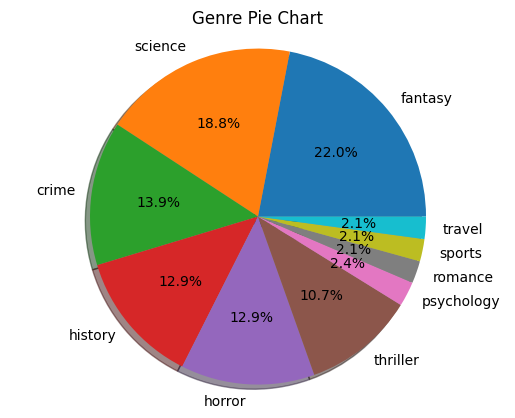

In [9]:
# count value for each genre
genre_counts = df['genre'].value_counts(dropna=False)

# define class names
class_names = ['fantasy', 'science', 'crime', 'history', 'horror', 'thriller', 'psychology', 'romance', 'sports', 'travel']

# create pie chart
plt.pie(genre_counts, autopct='%1.1f%%', labels=class_names, shadow=True)
plt.title('Genre Pie Chart')
plt.axis('equal')
plt.show()

From the pie chart aboove, it can be analyzed that the genre distribution in data isn't too equal. More than half the genres (fantasy, science, crime, history, horror, thriller) have similar shares (around 20%). Meanwhile, the others (psychology, romance, sports, travel) also have similar shares (around 2%).

---

## 4.2. Number of Sentences and Words in Each Genre

In [10]:
# count sentences and words in 'summary' column
df['sentence_count'] = df['summary'].apply(lambda x: len(nltk.sent_tokenize(x)))
df['word_count'] = df['summary'].apply(lambda x: len(nltk.word_tokenize(x)))

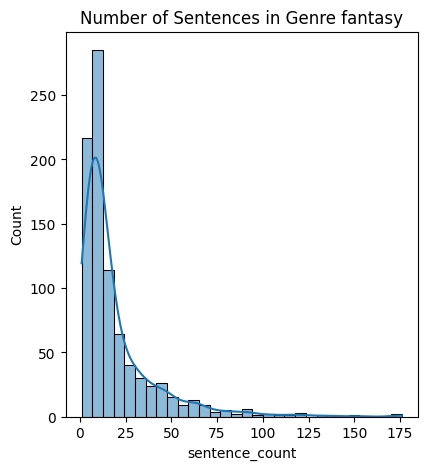

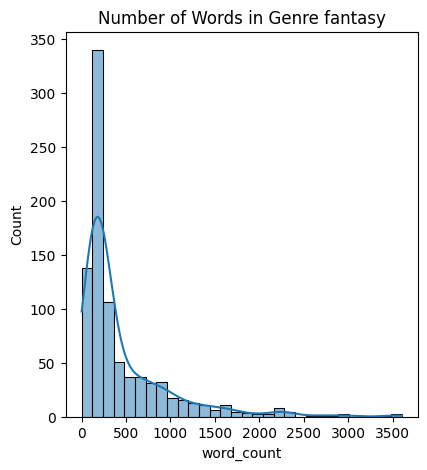

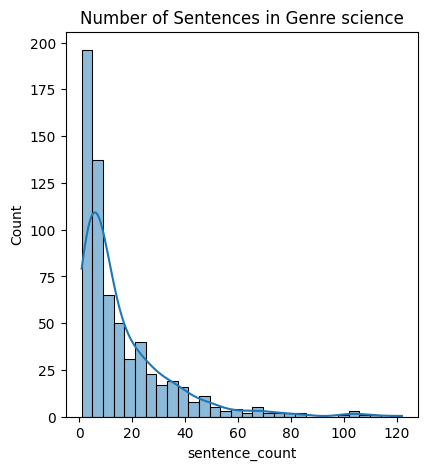

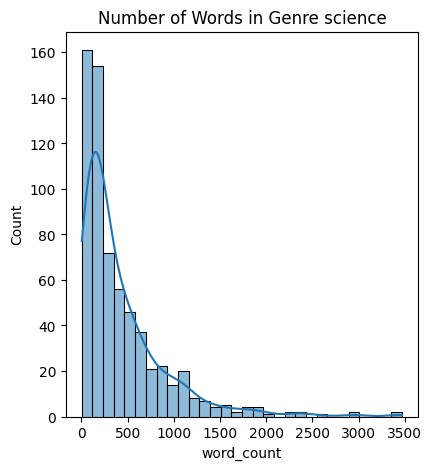

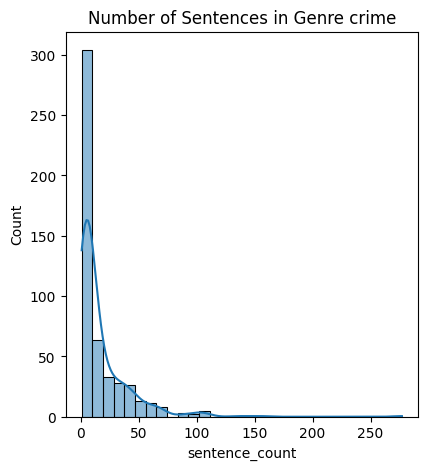

...

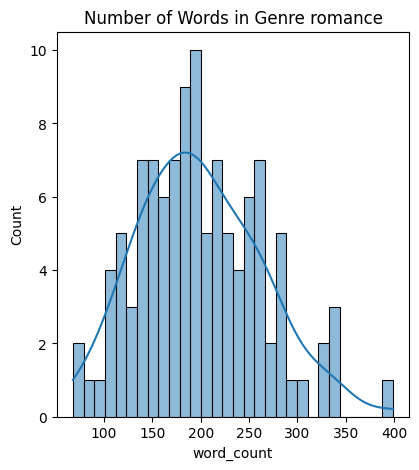

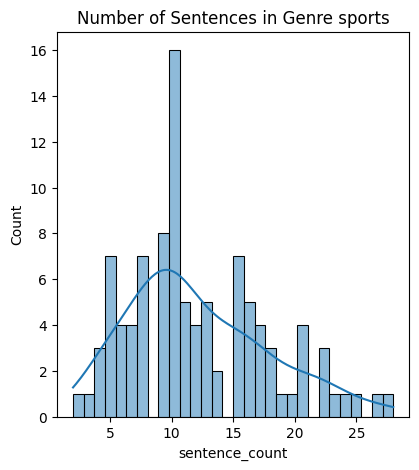

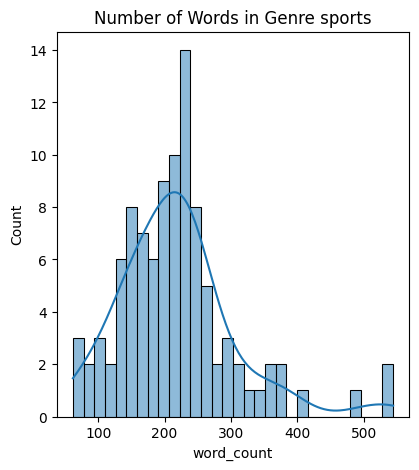

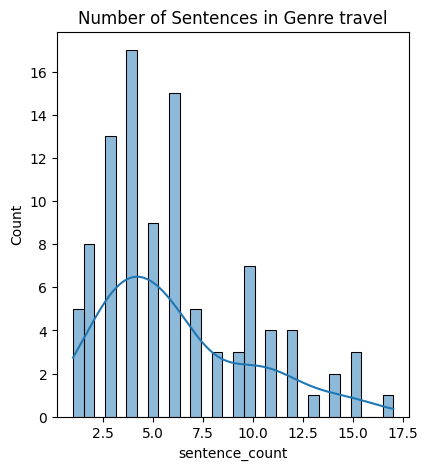

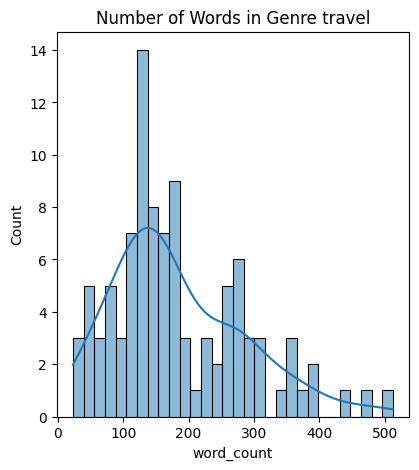

In [11]:
# create looping for each genre
for i in df['genre'].unique().tolist():

  # create histogram for number of sentences
  plt.figure(figsize=(10,5))
  plt.subplot(1,2,1)
  sns.histplot(df[df['genre'] == i]['sentence_count'], kde=True, bins = 30)
  plt.title(f'Number of Sentences in Genre {i}')
  plt.show()

  # create histogram for number of words
  plt.figure(figsize=(10,5))
  plt.subplot(1,2,1)
  sns.histplot(df[df['genre'] == i]['word_count'], kde=True, bins = 30)
  plt.title(f'Number of Words in Genre {i}')
  plt.show()

In [12]:
# create looping for each genre
for i in df['genre'].unique().tolist():

  # print max and average number of sentences
  print(f'max number of sentence in {i}: ', df[df['genre'] == i]['sentence_count'].max())
  print(f'average number of sentence in: {i} ', df[df['genre'] == i]['sentence_count'].mean())
  # print max and average number of words
  print(f'max number of words in {i}: ', df[df['genre'] == i]['word_count'].max())
  print(f'average number of words in {i}: ', df[df['genre'] == i]['word_count'].mean())
  print('')

max number of sentence in fantasy:  176
average number of sentence in: fantasy  18.893835616438356
max number of words in fantasy:  3605
average number of words in fantasy:  441.8527397260274

max number of sentence in science:  122
average number of sentence in: science  16.282843894899536
max number of words in science:  3471
average number of words in science:  425.46676970633695

max number of sentence in crime:  277
average number of sentence in: crime  17.226
max number of words in crime:  6335
average number of words in crime:  421.064

max number of sentence in history:  250
average number of sentence in: history  21.286666666666665
max number of words in history:  5709
average number of words in history:  540.3716666666667

max number of sentence in horror:  289
average number of sentence in: horror  20.601666666666667
max number of words in horror:  6598
average number of words in horror:  491.1166666666667

max number of sentence in thriller:  282
average number of sentence 

From the process above, it can be understood that the 'number of sentences' and 'number of words' plots are quite similar in each genre. It can also be analyzed that genres 'fantasy', 'science', 'crime', 'history', 'horror', and 'thriller' have relatively low of number of sentences and number of words. Meanwhile, genres ' psychology', 'romance', 'sports', and 'travel' have relatively higher number of sentences and number of words.

---
## 4.3. Wordcloud for Each Genre

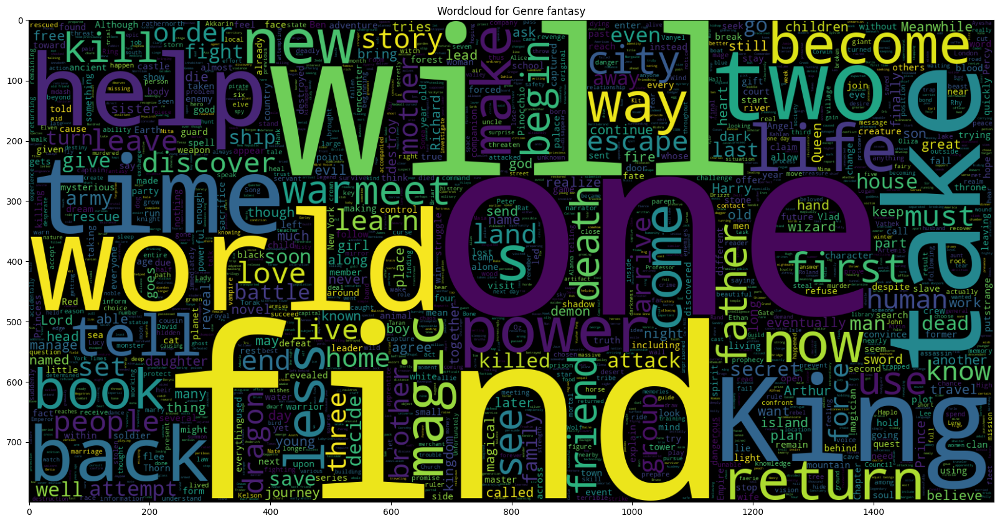

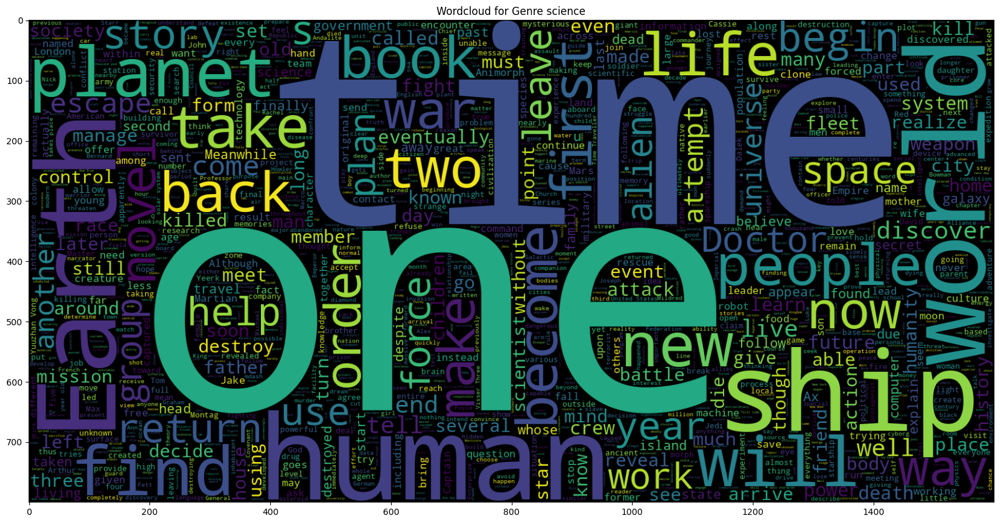

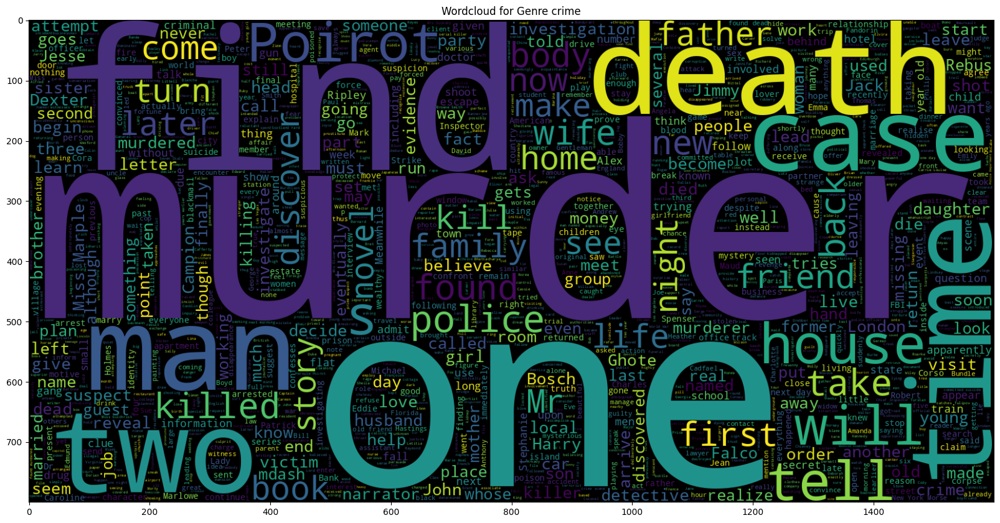

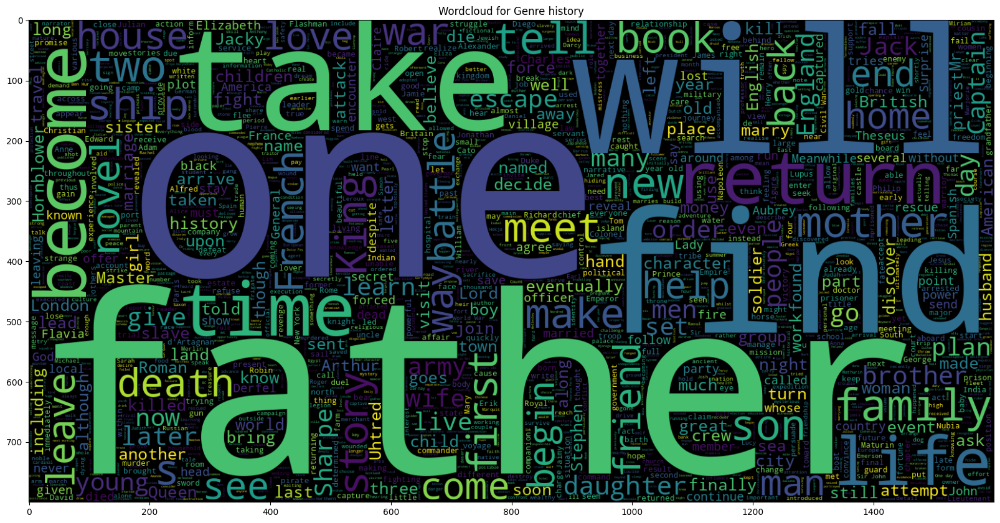

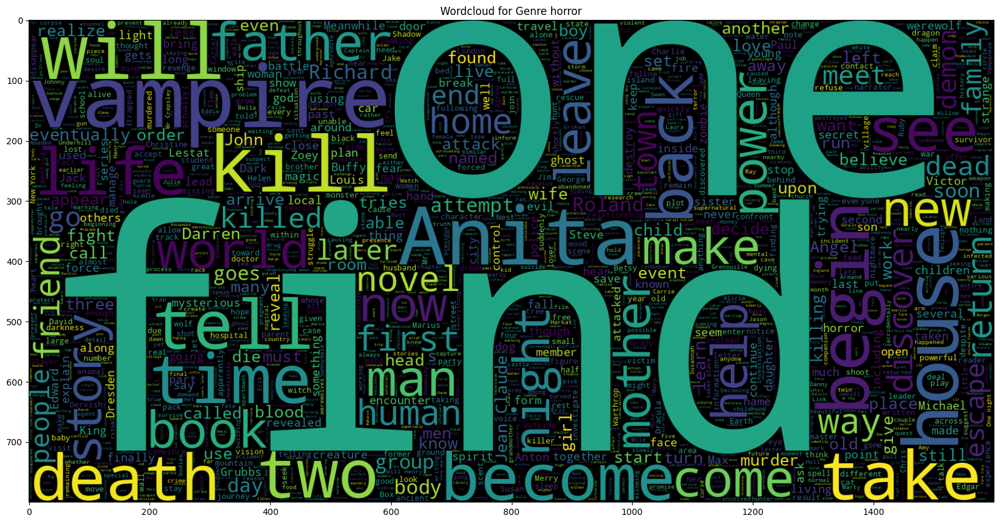

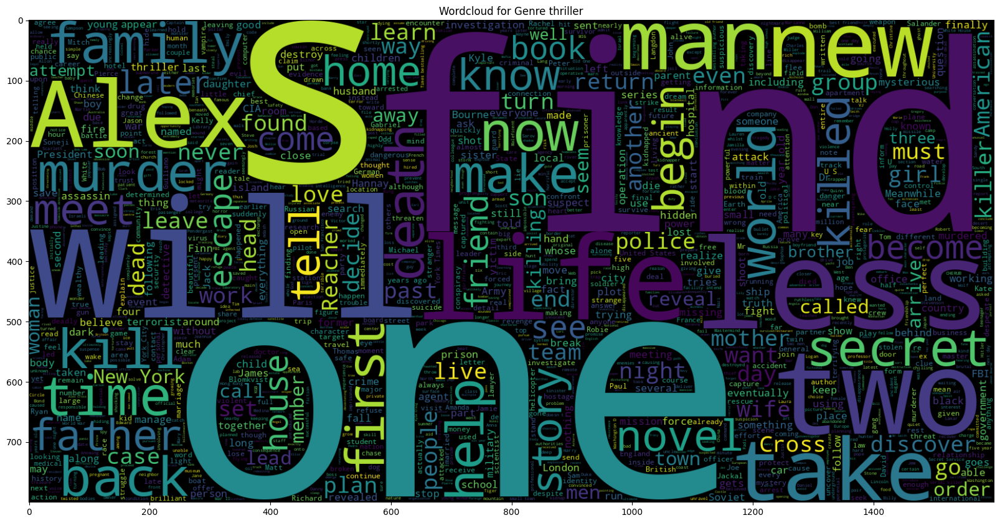

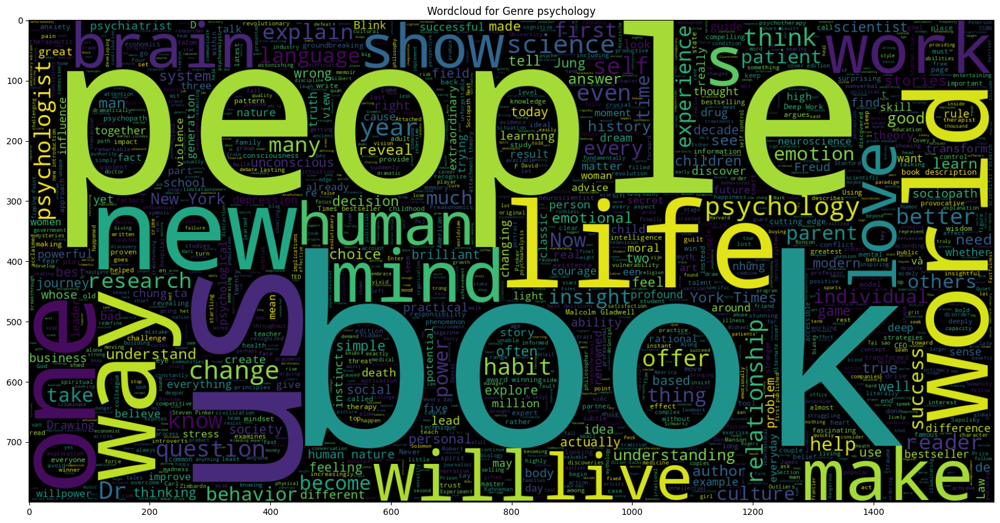

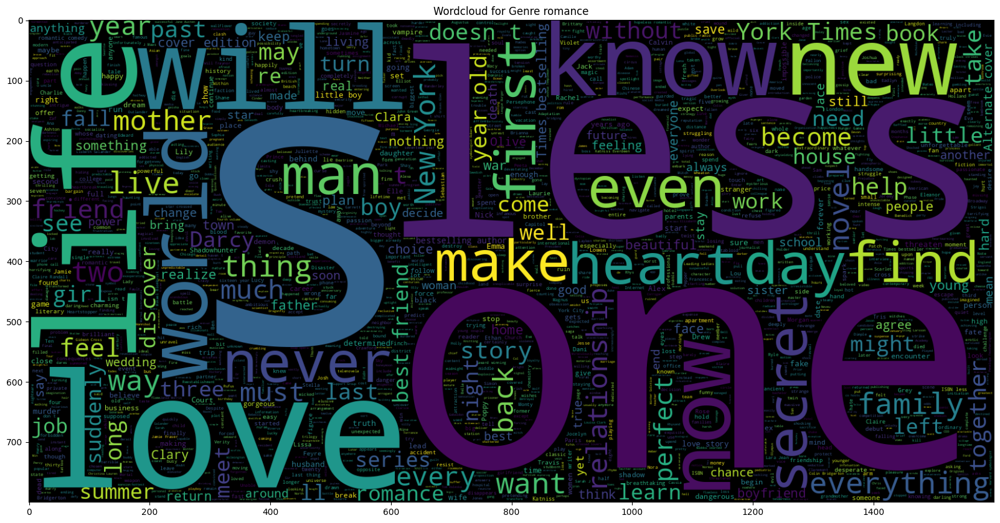

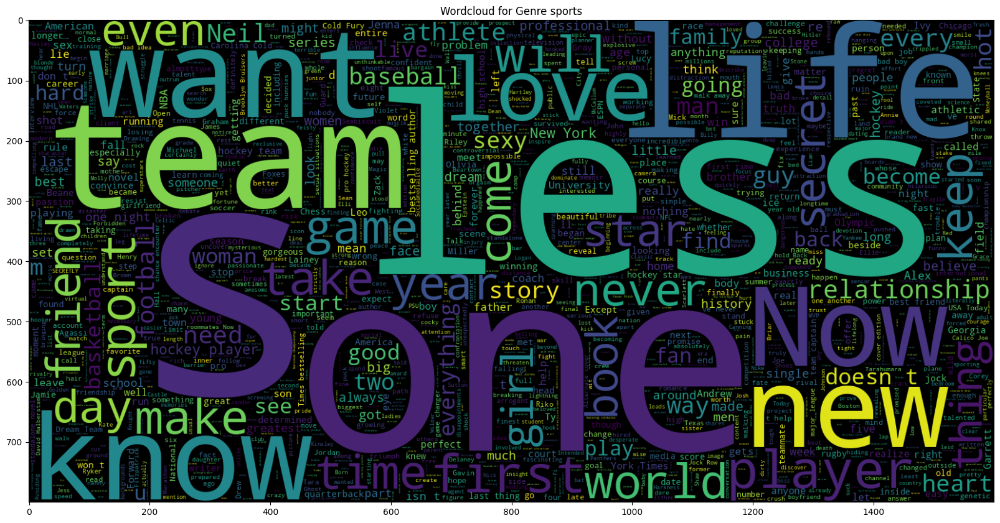

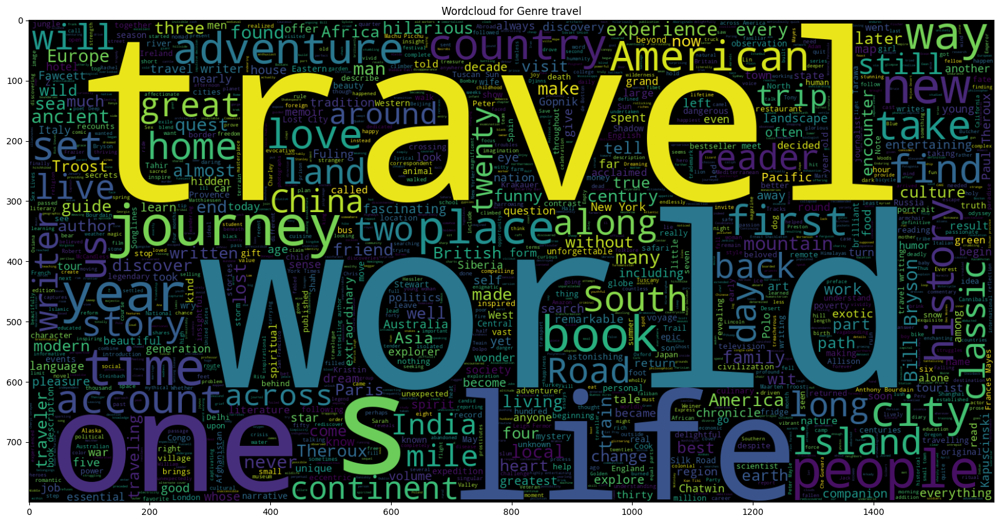

In [13]:
# create looping for each genre
for i in df['genre'].unique().tolist():

  # create wordcloud
  plt.figure(figsize = (20,20))
  wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(df[df.genre == i].summary))
  plt.title(f'Wordcloud for Genre {i}')
  plt.imshow(wc , interpolation = 'bilinear')

All genres have word 'one'.

- Fantasy: has many words correlating to time, world, king.
- Science: has many words correlating to planet, human, life.
- Crime: has many words correlating to death, case, and kill.
- History: has many words correlating to family.
- Horror: has many words correlating to kill and find.
- Thriller: quite similar with 'horror'.
- Psychology: has many words correlating to human and mind.
- Romance: has many words correlating to love and life.
- Sports: has many words correlating to player and teamwork.
- Travel: has many words having location names and words having similar meaning to 'travel'.

---
---

# 5. Feature Engineering

## 5.1. Drop Unused Columns

Column 'index' and 'title' are dropped because the only column used for NLP is 'summary'. Meanwhile, column 'genre' is not deleted because it is used as the label.

In [14]:
# drop 'index' and 'title'
df.drop(columns=['index', 'title'], inplace=True)

---

## 5.2. Missing Values

In [15]:
# check missing values
df.isnull().sum()

genre             0
summary           0
sentence_count    0
word_count        0
dtype: int64

There are no missing values in data.

---

## 5.3. Duplicated Data

In [16]:
# check duplicated data
df.duplicated().sum()

18

There are duplicated data. Therefore, they have to be dropped.

In [17]:
# drop duplicated data
df.drop_duplicates(inplace = True)

In [18]:
# check duplicated data after dropping
df.duplicated().sum()

0

Now, there are no more duplicated data.

---

## 5.4. Text Preprocessing

With text preprocessing, it is expected that the dimentionality in data can be decreased. Thus, minimizing probability of the model being an overfit.

Data scientist will check the number of sentences and words in data before text preprocessing.

In [19]:
# show number of sentences and words
print('Average Number of Sentences:', df['sentence_count'].mean())
print('Average Number of Words:', df['word_count'].mean())re

Average Number of Sentences: 17.120068980383703
Average Number of Words: 412.08687217072645


Data scientist will use function to do text preprocessing.

In [20]:
# define stopwords
stopwords_eng = stopwords.words('english')

In [21]:
# create text preprocessing function
def text_preprocessing(text):
  '''
  This function is created to do text preprocessing: change text to lowercase, remove numbers and punctuation symbols, remove stopwords,
  lemmatize text, and tokenize text. Text preprocessing can be done just by calling this function.
  '''
  # change text to lowercase
  text = text.lower()

  # remove [UNK]
  text = text.replace('[UNK]', '')
  text = text.replace('unk', '')
  text = text.replace('UNK', '')
  text = text.replace('[unk]', '')

  # remove numbers
  text = re.sub(r'\d+', '', text)

  # remove comma
  text = text.replace(',', '')

  # remove period symbol
  text = text.replace('.', '')

  # remove exclamation mark
  text = text.replace('!', '')

  # remove question mark
  text = text.replace('?', '')

  # change texts using quotation marks that have negative connotation
  text = text.replace("don't", "do not")
  text = text.replace("aren't", "are not")
  text = text.replace("isn't", "is not")
  text = text.replace("didn't", "did not")
  text = text.replace("can't", "cannot")
  text = text.replace("couldn't", "could not")
  text = text.replace("didn't", "did not")

  # remove quotation mark
  text = text.replace('"', '')
  text = text.replace("'", '')
  text = text.replace('’', '')

  # remove whitespace
  text = text.strip()

  # tokenization
  tokens = word_tokenize(text)

  # remove stopwords
  tokens = [word for word in tokens if word not in stopwords_eng]

  # lemmatization: minimize words with same or similar meaning
  lemmatizer = WordNetLemmatizer()
  tokens = [lemmatizer.lemmatize(word) for word in tokens]

  # combine tokens
  text = ' '.join(tokens)

  return text

The function made in last step will be applied to data.

In [22]:
# apply text_preprocessing function to data
df['text_processed'] = df['summary'].apply(lambda x: text_preprocessing(x))
df

,genre,summary,sentence_count,word_count,text_processed
0,fantasy,Drowned Wednesday is the first Trustee among ...,45,936,drowned wednesday first trustee among morrow d...
1,fantasy,"As the book opens, Jason awakens on a school ...",21,653,book open jason awakens school bus unable reme...
2,fantasy,Cugel is easily persuaded by the merchant Fia...,13,393,cugel easily persuaded merchant fianosther att...
3,fantasy,The book opens with Herald-Mage Vanyel return...,46,903,book open herald-mage vanyel returning country...
4,fantasy,Taran and Gurgi have returned to Caer Dallben...,66,1358,taran gurgi returned caer dallben following ev...
...,...,...,...,...,...
4652,fantasy,"Atticus O’Sullivan, last of the Druids, lives ...",6,172,atticus osullivan last druid life peacefully a...
4653,fantasy,Charlie Bucket's wonderful adventure begins wh...,3,49,charlie bucket wonderful adventure begin find ...
4654,fantasy,"""I live for the dream that my children will be...",17,284,live dream child born free say like land fathe...
4655,fantasy,"Rose loves Dimitri, Dimitri might love Tasha, ...",8,206,rose love dimitri dimitri might love tasha mas...


In [23]:
# count sentences and words in 'text_processed' column after text preprocessing
df['sentence_count_processed'] = df['text_processed'].apply(lambda x: len(nltk.sent_tokenize(x)))
df['word_count_processed'] = df['text_processed'].apply(lambda x: len(nltk.word_tokenize(x)))

In [24]:
# show number of sentences and words after text preprocessing
print('Average Number of Sentences:', df['sentence_count_processed'].mean())
print('Average Number of Words:', df['word_count_processed'].mean())

Average Number of Sentences: 1.0
Average Number of Words: 200.7439103255012


It can be seen that the text preprocessing is a success because there is a decrease in number of sentences and words in data.

---

## 5.5. Encode Label and Split Data

In [25]:
# show unique values in 'genre' column
df['genre'].unique()

array(['fantasy', 'science', 'crime', 'history', 'horror', 'thriller',
       'psychology', 'romance', 'sports', 'travel'], dtype=object)

Data scientits will convert label to numbers so that the model can process data.

In [26]:
# change label name to number
df['label'] = df['genre'].replace({'fantasy' : 0, 'science' : 1, 'crime' : 2, 'history' : 3, 'horror' : 4, 'thriller' : 5, 'psychology' : 6, 'romance' : 7, 'sports' : 8, 'travel' : 9})
df

,genre,summary,sentence_count,word_count,text_processed,sentence_count_processed,word_count_processed,label
0,fantasy,Drowned Wednesday is the first Trustee among ...,45,936,drowned wednesday first trustee among morrow d...,1,447,0
1,fantasy,"As the book opens, Jason awakens on a school ...",21,653,book open jason awakens school bus unable reme...,1,293,0
2,fantasy,Cugel is easily persuaded by the merchant Fia...,13,393,cugel easily persuaded merchant fianosther att...,1,187,0
3,fantasy,The book opens with Herald-Mage Vanyel return...,46,903,book open herald-mage vanyel returning country...,1,438,0
4,fantasy,Taran and Gurgi have returned to Caer Dallben...,66,1358,taran gurgi returned caer dallben following ev...,1,670,0
...,...,...,...,...,...,...,...,...
4652,fantasy,"Atticus O’Sullivan, last of the Druids, lives ...",6,172,atticus osullivan last druid life peacefully a...,1,87,0
4653,fantasy,Charlie Bucket's wonderful adventure begins wh...,3,49,charlie bucket wonderful adventure begin find ...,1,31,0
4654,fantasy,"""I live for the dream that my children will be...",17,284,live dream child born free say like land fathe...,1,124,0
4655,fantasy,"Rose loves Dimitri, Dimitri might love Tasha, ...",8,206,rose love dimitri dimitri might love tasha mas...,1,105,0


Now, data scientist will split data into train, test, and validation.

In [27]:
# split datadata to x_train, x_test, y_train, y_test
x_train, x_test, y_train, y_test = train_test_split(df.text_processed, df.label, test_size = 0.2, random_state = 12, stratify = df.genre)

# split x_train and y_train to x_train, x_val, y_train, y_val
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size = 0.15, stratify = y_train)

# check data shape
print('Training Data Size:', x_train.shape[0])
print('Validation Data Size:', x_val.shape[0])
print('Testing Data Size:', x_test.shape[0])

Training Data Size: 3154
Validation Data Size: 557
Testing Data Size: 928


The label will now be one hot encoded.

In [28]:
# encode label
y_train_ohe = to_categorical(y_train)
y_val_ohe = to_categorical(y_val)
y_test_ohe = to_categorical(y_test)

# show y_train after encoding
y_train_ohe

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 1.]], dtype=float32)

---

## 5.6. Text Vectorization

Data scientist will now convert the text into vectors so that model can process data better.

In [29]:
# get vocabularies
Vectorize = CountVectorizer()
x_train_vec = Vectorize.fit_transform(x_train)
x_test_vec = Vectorize.transform(x_test)

x_train_vec

<3154x43603 sparse matrix of type '<class 'numpy.int64'>'
	with 443365 stored elements in Compressed Sparse Row format>

In [30]:
# define number of vocabs in document
total_vocab = len(Vectorize.vocabulary_.keys())

# define max token length in document
max_sen_len = max([len(i.split(" ")) for i in x_train])

# print number of vocabs and token length
print('Total Vocab : ', total_vocab)
print('Maximum Sentence Length : ', max_sen_len, 'tokens')

Total Vocab :  43603
Maximum Sentence Length :  3020 tokens


In [31]:
# define text vectorization
text_vectorization = TextVectorization(max_tokens=total_vocab,
                                       standardize="lower_and_strip_punctuation",
                                       split="whitespace",
                                       ngrams=None,
                                       output_mode="int",
                                       output_sequence_length=max_sen_len,
                                       input_shape=(1,))

# fit text vectorization to data
text_vectorization.adapt(x_train)

In [32]:
# result example

# document result
print('Document example')
print(df.text_processed[0])
print('')

# text vectorization result
print('Result of Text Vectorization')
print(text_vectorization([df.text_processed[0]]))
print('Vector size : ', text_vectorization([df.text_processed[0]]).shape)

Document example
drowned wednesday first trustee among morrow day arthur side wish fulfilled appears leviathan/whale suffers gluttony book begin leaf visiting arthur discussing invitation drowned wednesday sent arthur admitted hospital damage done leg attempted enter tuesday treasure tower suddenly hospital room becomes flooded water two transported border sea house leaf snatched away large ship green sail known flying mantis arthur remains bed medallion given immortal called mariner apparently fails summon help arthur without hope eventually buoy marking pirate elishar feverfew treasure float toward soon arthur open hand marked bloody red colour arthur red hand feverfew mark whoever found treasure identify later long scavenging ship called moth rescue arthur board arthur ( going name arth ) introduced sunscorch first mate captain catapillow journey brings line storm border sea later pursued feverfew ghostly ship shiver damage inflicted moth serious ; therefore sunscorch command upper 

In [33]:
# show 20 most frequent tokens
text_vectorization.get_vocabulary()[:20]

['',
 '[UNK]',
 'one',
 'find',
 'life',
 'time',
 'new',
 'take',
 'two',
 'also',
 'year',
 'world',
 'back',
 'go',
 'book',
 'man',
 'story',
 'first',
 'father',
 'tell']

## 5.7. Word Embedding

In [34]:
# define embedding
embedding = Embedding(input_dim=total_vocab,
                      output_dim=128,
                      embeddings_initializer="uniform",
                      input_length=max_sen_len)

In [35]:
# result example

# document example
print('Document example')
print(df.text_processed[0])
print('')

# text vectorization result
print('Result of  Text Vectorization')
print(text_vectorization([df.text_processed[0]]))
print('Vector size : ', text_vectorization([df.text_processed[0]]).shape)
print('')

# embedding result
print('Result of Embedding')
print(embedding(text_vectorization([df.text_processed[0]])))
print('Vector size : ', embedding(text_vectorization([df.text_processed[0]])).shape)

Document example
drowned wednesday first trustee among morrow day arthur side wish fulfilled appears leviathan/whale suffers gluttony book begin leaf visiting arthur discussing invitation drowned wednesday sent arthur admitted hospital damage done leg attempted enter tuesday treasure tower suddenly hospital room becomes flooded water two transported border sea house leaf snatched away large ship green sail known flying mantis arthur remains bed medallion given immortal called mariner apparently fails summon help arthur without hope eventually buoy marking pirate elishar feverfew treasure float toward soon arthur open hand marked bloody red colour arthur red hand feverfew mark whoever found treasure identify later long scavenging ship called moth rescue arthur board arthur ( going name arth ) introduced sunscorch first mate captain catapillow journey brings line storm border sea later pursued feverfew ghostly ship shiver damage inflicted moth serious ; therefore sunscorch command upper 

---
---

# 6. ANN Training (Sequential API/Functional API)

## 6.1. Model Definition

For the first model, data scientist will use Sequential API.

In [36]:
# clear session
seed = 20
tf.keras.backend.clear_session()
np.random.seed(seed)
tf.random.set_seed(seed)

# define learning rate schedule
learning_rate_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=10000,
    decay_rate=0.96
)

# define optimizer
optimizer_adam = tf.keras.optimizers.Adam(learning_rate=learning_rate_schedule)

# define model architecture
# create sequential API
model_1 = Sequential()
# text vectorization: use fitted text vectorization
model_1.add(text_vectorization)
# embedding
model_1.add(embedding)
# lstm 1
model_1.add(LSTM(units=256, return_sequences=True))
# dropout 1: minimize overfitting
model_1.add(Dropout(0.1))
# lstm 2
model_1.add(LSTM(units=128, return_sequences=True))
# dropout 2: minimize overfitting
model_1.add(Dropout(0.1))
# lstm 3
model_1.add(LSTM(units=64, return_sequences=True))
# dropout 3: minimize overfitting
model_1.add(Dropout(0.1))
# lstm 4
model_1.add(LSTM(units=32, return_sequences=True))
# dropout 4: minimize overfitting
model_1.add(Dropout(0.1))
# lstm 5
model_1.add(LSTM(units=16))
# dropout 5: minimize overfitting
model_1.add(Dropout(0.1))
# output layer
model_1.add(Dense(10, activation='softmax')) # softmax is used because this is a multiclass classification case

# compile
model_1.compile(optimizer=optimizer_adam, metrics='accuracy', loss='categorical_crossentropy')

# show model summary
model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 text_vectorization (TextVe  (None, 3020)              0         
 ctorization)                                                    
                                                                 
 embedding (Embedding)       (None, 3020, 128)         5581184   
                                                                 
 lstm (LSTM)                 (None, 3020, 256)         394240    
                                                                 
 dropout (Dropout)           (None, 3020, 256)         0         
                                                                 
 lstm_1 (LSTM)               (None, 3020, 128)         197120    
                                                                 
 dropout_1 (Dropout)         (None, 3020, 128)         0         
                                                        

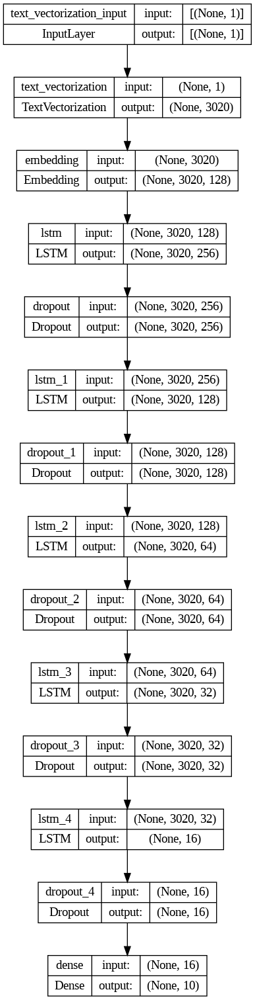

In [37]:
# plot layers in model 1
tf.keras.utils.plot_model(model_1, show_shapes=True)

---
## 6.2. Model Training

In [38]:
# define earlystopping callback
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)

In [39]:
# train model
%%time
history_1 = model_1.fit(x_train, y_train_ohe, batch_size=100, epochs=100, validation_data=(x_val, y_val_ohe), callbacks=callback)

Epoch 1/100
32/32 [==============================] - 39s 892ms/step - loss: 2.1124 - accuracy: 0.1791 - val_loss: 2.0363 - val_accuracy: 0.2208
Epoch 2/100
32/32 [==============================] - 27s 859ms/step - loss: 2.0418 - accuracy: 0.2159 - val_loss: 2.0223 - val_accuracy: 0.2208
Epoch 3/100
32/32 [==============================] - 28s 863ms/step - loss: 2.0417 - accuracy: 0.1966 - val_loss: 2.0197 - val_accuracy: 0.2208
Epoch 4/100
32/32 [==============================] - 28s 864ms/step - loss: 2.0347 - accuracy: 0.2032 - val_loss: 2.0185 - val_accuracy: 0.2208
Epoch 5/100
32/32 [==============================] - 35s 1s/step - loss: 2.0375 - accuracy: 0.2127 - val_loss: 2.0183 - val_accuracy: 0.2208
Epoch 6/100
32/32 [==============================] - 28s 880ms/step - loss: 2.0308 - accuracy: 0.2016 - val_loss: 2.0182 - val_accuracy: 0.2208
Epoch 7/100
32/32 [==============================] - 28s 877ms/step - loss: 2.0372 - accuracy: 0.2067 - val_loss: 2.0182 - val_accuracy: 0.

---
## 6.3. Model Evaluation

### 6.3.A. Training and Validation Set

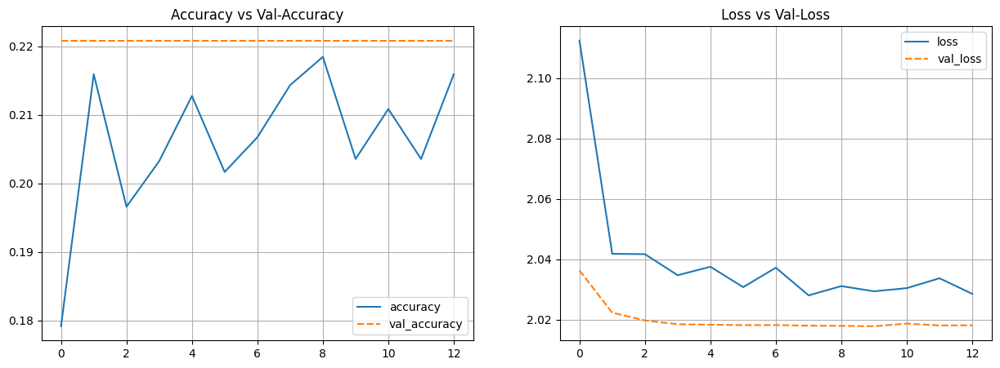

In [40]:
# plot training results

# insert model history to dataframe
model_1_history_df = pd.DataFrame(history_1.history)

# create plot
plt.figure(figsize=(15, 5))

# show plot for accuracy
plt.subplot(1, 2, 1)
sns.lineplot(data=model_1_history_df[['accuracy', 'val_accuracy']])
plt.grid()
plt.title('Accuracy vs Val-Accuracy')

# show plot for loss
plt.subplot(1, 2, 2)
sns.lineplot(data=model_1_history_df[['loss', 'val_loss']])
plt.grid()
plt.title('Loss vs Val-Loss')
plt.show()

***From the plots above, it can be seen that the model is an underfit.***

`Accuracy Plot`
- The accuracy for validation data remains flat.
- The accuracy values for both training and validation data are quite bad. Accuracy metric measures how much correct predictions the model made and has range of 0-1. Meanwhile, both training and validation data have accuracy score of around 0.2, which can be deemed as low.

`Loss Plot`
- Training and validation loss continues to decrease.
- The loss value for both training and validation data are quite high, both having loss value of around 2.

---
### 6.3.B. Test Set

Data scientist will use first model to make predictions using test set, and use the predictions to evaluate the model by comparing with the actual label.

In [41]:
# make prediction
# calculate probability
y_pred_test_1 = model_1.predict(x_test)
# take class with biggest probability
y_pred_test_1 = np.argmax(y_pred_test_1, axis=-1)

29/29 [==============================] - 8s 195ms/step


In [42]:
# prepare label for concat
## reset index
y_test_1 = y_test.reset_index(drop=True)
## insert to dataframe
y_test_1 = pd.DataFrame(y_test_1)

# prepare feature for concat
## reset index
x_test_1 = x_test.reset_index(drop=True)
## insert to dataframe
x_test_1 = pd.DataFrame(x_test_1)

# prepare prediction for concat
## reshape
y_pred_test_1 = y_pred_test_1.reshape(-1, 1)
## insert to dataframe
y_pred_test_1 = pd.DataFrame(y_pred_test_1)

# make evaluation table
model1_eval = pd.concat([x_test_1, y_test_1, y_pred_test_1], axis=1)
model1_eval = model1_eval.reset_index(drop=True)
model1_eval = model1_eval.rename(columns={0: 'prediction'})

# show evaluation table
model1_eval.head()

,text_processed,label,prediction
0,mina last appeared rhys adult woman seems reta...,0,5
1,crystal gregory beautiful new teacher sunnydal...,4,5
2,new york time bestselling queen twist returns…...,5,5
3,prince rupert taken roundhead ; held captive c...,0,5
4,coded message smuggled russia plea help supers...,5,5


In [43]:
# show classification report
print('Model 1 Classification Report (Test) : \n',classification_report(model1_eval['label'], model1_eval['prediction']))

Model 1 Classification Report (Test) : 
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       175
           1       0.00      0.00      0.00       129
           2       0.00      0.00      0.00       100
           3       0.00      0.00      0.00       120
           4       0.00      0.00      0.00       120
           5       0.22      1.00      0.36       205
           6       0.00      0.00      0.00        20
           7       0.00      0.00      0.00        22
           8       0.00      0.00      0.00        17
           9       0.00      0.00      0.00        20

    accuracy                           0.22       928
   macro avg       0.02      0.10      0.04       928
weighted avg       0.05      0.22      0.08       928



<Axes: >

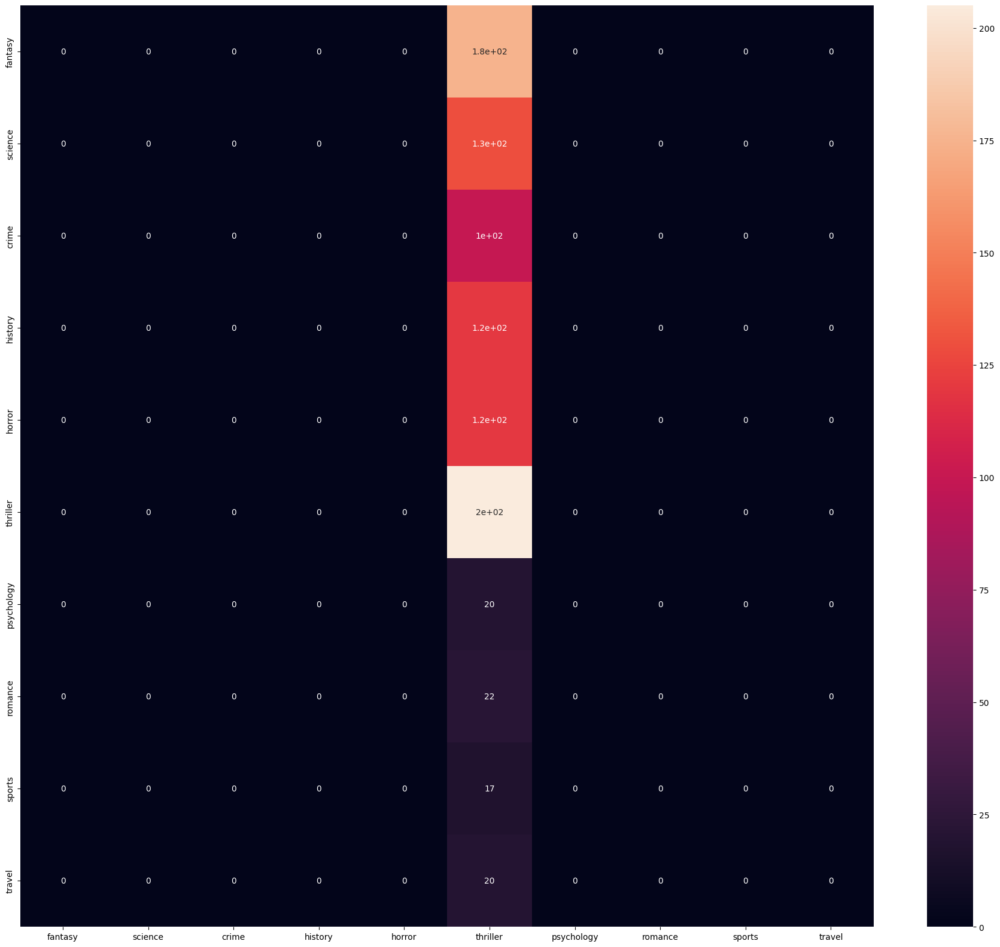

In [44]:
# show confusion matrix
np.set_printoptions(suppress=True)
plt.figure(figsize=(23, 20))
model1_confusionmatrix = confusion_matrix(model1_eval['label'], model1_eval['prediction'])
sns.heatmap(model1_confusionmatrix, annot=True , xticklabels=class_names, yticklabels=class_names)

Now, data scientist will analyze the incorrect predictions made by model.

In [45]:
# define incorrect predictions
incorrect_predictions_1 = model1_eval[model1_eval['label'] != model1_eval['prediction']]

# show incorrect predictions
incorrect_predictions_1.head()

,text_processed,label,prediction
0,mina last appeared rhys adult woman seems reta...,0,5
1,crystal gregory beautiful new teacher sunnydal...,4,5
3,prince rupert taken roundhead ; held captive c...,0,5
6,year claire randall former combat nurse back w...,0,5
8,book open world university toronto five main c...,0,5


In [46]:
# create looping for label and prediction
for i in ['label', 'prediction']:
  # count frequency of unique values in label and prediction
  print(incorrect_predictions_1[i].value_counts())
  print('')

label
0    175
1    129
4    120
3    120
2    100
7     22
6     20
9     20
8     17
Name: count, dtype: int64

prediction
5    723
Name: count, dtype: int64



From the processes above, it can be understood that all genres except '5' or 'thriller' have 0 for the evaluation scores using all metrics. This shows that model can only predict data with genre 'thriller' and cannot predict other genres at all.

In [47]:
dict_class = {0: 'fantasy',
              1: 'science',
              2: 'crime',
              3: 'history',
              4: 'horror',
              5: 'thriller',
              6: 'psychology',
              7: 'romance',
              8: 'sports',
              9: 'travel'}

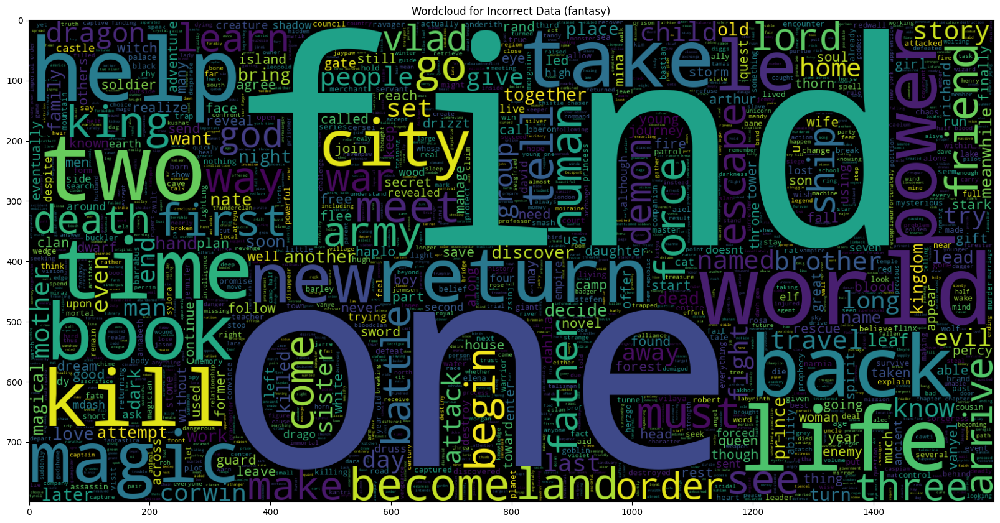

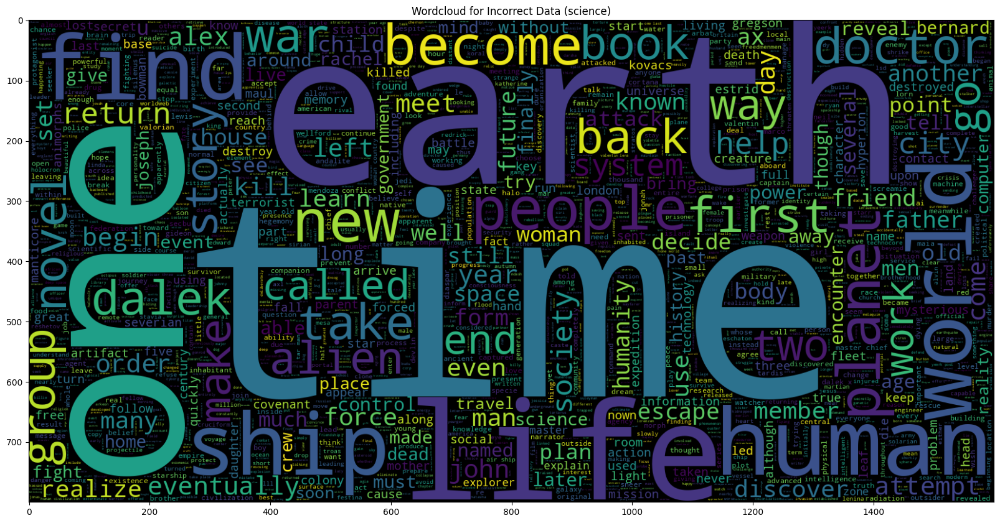

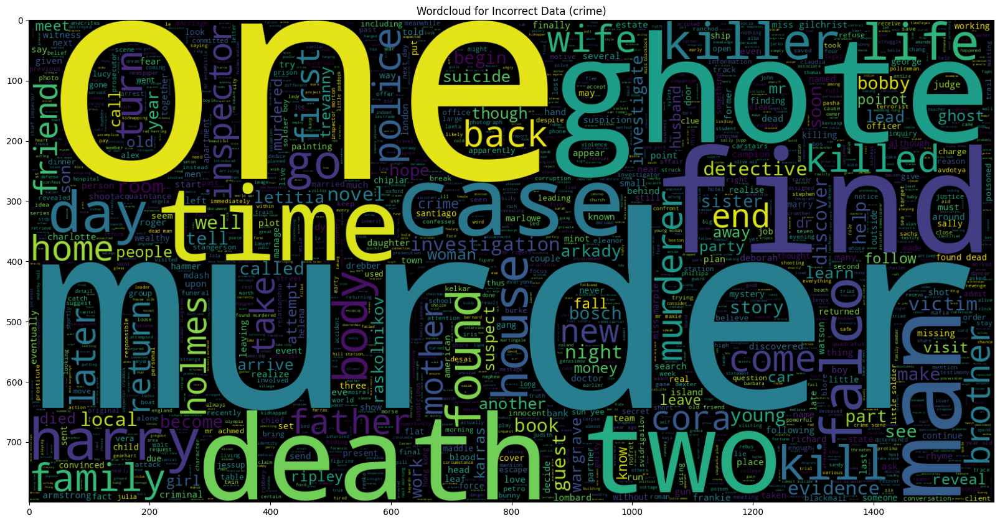

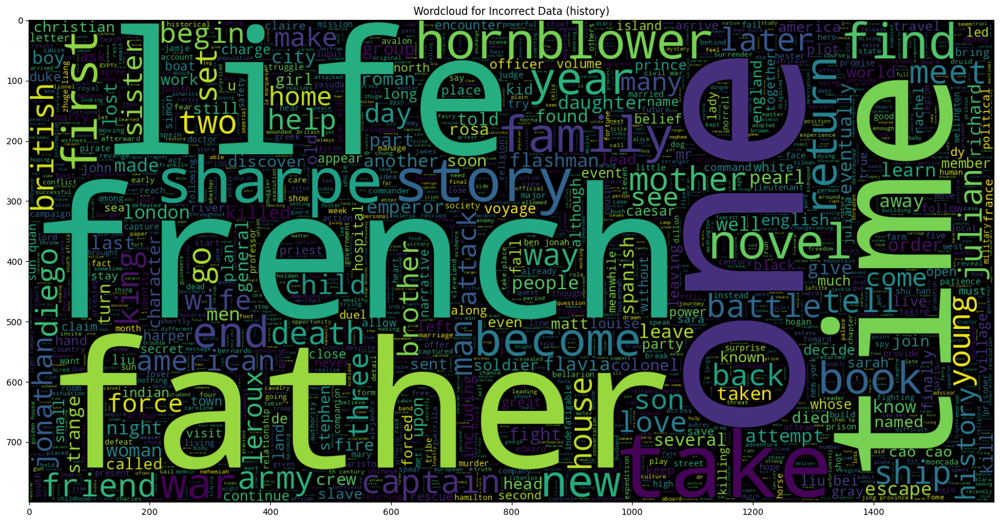

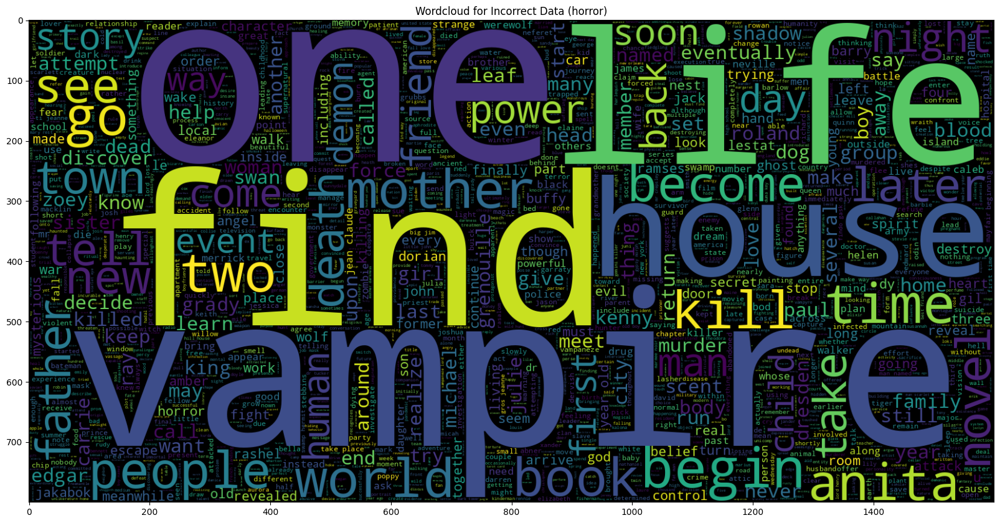

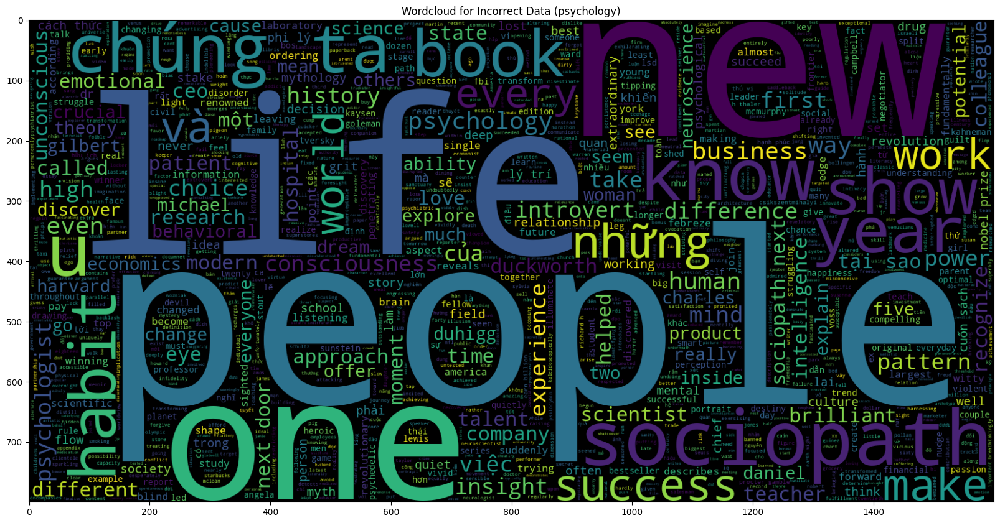

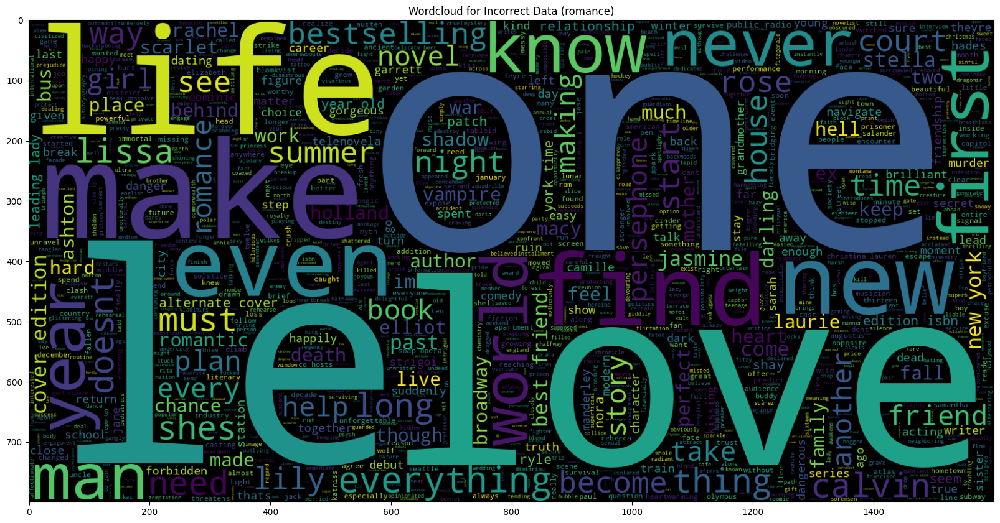

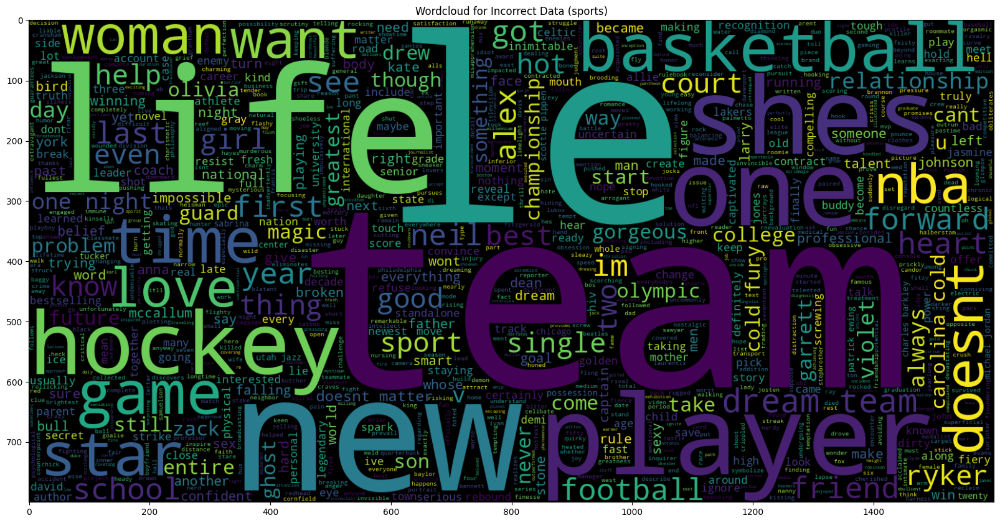

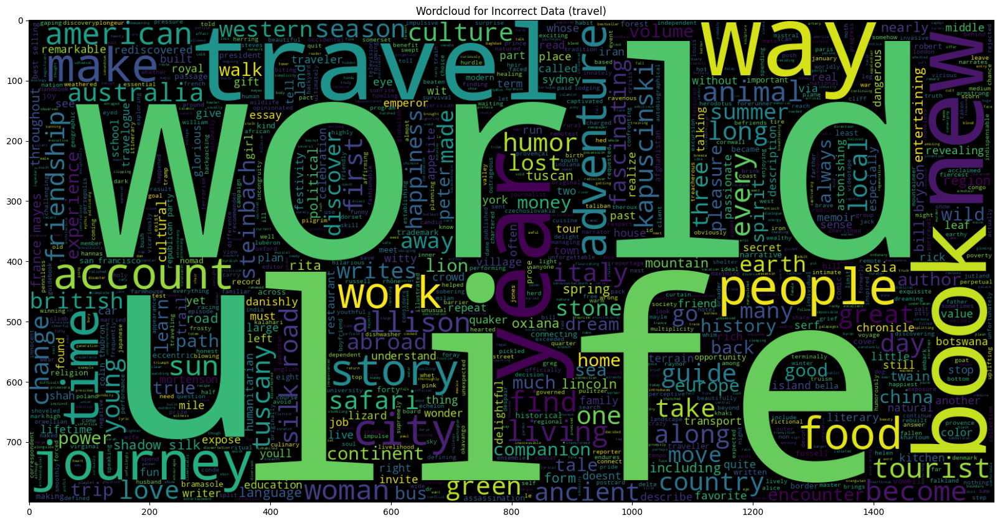

In [48]:
# show wordcloud for incorrect predictions
## create looping for all genres except thriller
for i in [0, 1, 2, 3, 4, 6, 7, 8, 9]:
  ## create wordcloud
  plt.figure(figsize = (20,20))
  wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(incorrect_predictions_1[incorrect_predictions_1.label == i].text_processed))
  plt.title(f'Wordcloud for Incorrect Data ({dict_class[i]})')
  plt.imshow(wc , interpolation = 'bilinear')

From the wordclouds above, it was obtained that the characteristics in overall data and data with indorrect predictions are quite similar. 

### 6.3.C. Model Strengths and Weaknesses
`Strengths`
- Model can run properly.
- Model can predict genre 'thriller' well.

`Weaknesses`
- Model cannot predict other genres besides 'thriller'.
- Model has high loss score.
- Model has low accuracy score, which means that there are many incorrect predictions.

---
---

# 7. ANN Improvement (Sequential API/Functional API)

## 7.1. Model Definition

To improve model, data scientist will use transfer learning. With transfer learning, data scientist can use layer that was already trained with better resources. With this, it is expected that model can make better predictions.

The pre-trained layer is obtained from [kaggle.com](https://www.kaggle.com/).

In [49]:
# get pretrained layer from kaggle
url = 'https://tfhub.dev/google/tf2-preview/nnlm-id-dim128-with-normalization/1'
pretrained_layer = tf_hub.KerasLayer(url, output_shape=[128], input_shape=[], dtype=tf.string)

In [50]:
# clear session
seed = 20
tf.keras.backend.clear_session()
np.random.seed(seed)
tf.random.set_seed(seed)

# define learning rate schedule
learning_rate_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=10000,
    decay_rate=0.96
)

# define optimizer
optimizer_adam = tf.keras.optimizers.Adam(learning_rate=learning_rate_schedule)

# define model architecture
# create sequential API
model_2 = Sequential()
# pretrained layer: transfer learning
model_2.add(pretrained_layer)
# reshape
model_2.add(Reshape((128, 1)))
# lstm 1
model_2.add(LSTM(units=256, return_sequences=True))
# dropout 1: minimize overfitting
model_2.add(Dropout(0.1))
# lstm 2
model_2.add(LSTM(units=128, return_sequences=True))
# dropout 2: minimize overfitting
model_2.add(Dropout(0.1))
# lstm 3
model_2.add(LSTM(units=64, return_sequences=True))
# dropout 3: minimize overfitting
model_2.add(Dropout(0.1))
# lstm 4
model_2.add(LSTM(units=32, return_sequences=True))
# dropout 4: minimize overfitting
model_2.add(Dropout(0.1))
# lstm 5
model_2.add(LSTM(units=16))
# dropout 5: minimize overfitting
model_2.add(Dropout(0.1))
# output layer
model_2.add(Dense(10, activation='softmax')) # using softmax because this case is a multiclass classification case

# compile
model_2.compile(optimizer=optimizer_adam, metrics='accuracy', loss='categorical_crossentropy')

# show improved model summary
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 128)               112461824 
                                                                 
 reshape (Reshape)           (None, 128, 1)            0         
                                                                 
 lstm (LSTM)                 (None, 128, 256)          264192    
                                                                 
 dropout (Dropout)           (None, 128, 256)          0         
                                                                 
 lstm_1 (LSTM)               (None, 128, 128)          197120    
                                                                 
 dropout_1 (Dropout)         (None, 128, 128)          0         
                                                                 
 lstm_2 (LSTM)               (None, 128, 64)           4

---
## 7.2. Model Training

In [51]:
# train model
%%time
history_2 = model_2.fit(x_train, y_train_ohe, batch_size=100, epochs=100, validation_data=(x_val, y_val_ohe), callbacks=callback)

Epoch 1/100
32/32 [==============================] - 12s 99ms/step - loss: 2.1413 - accuracy: 0.1877 - val_loss: 2.0501 - val_accuracy: 0.2154
Epoch 2/100
32/32 [==============================] - 1s 42ms/step - loss: 2.0515 - accuracy: 0.2086 - val_loss: 2.0265 - val_accuracy: 0.2208
Epoch 3/100
32/32 [==============================] - 1s 44ms/step - loss: 2.0394 - accuracy: 0.2181 - val_loss: 2.0233 - val_accuracy: 0.2208
Epoch 4/100
32/32 [==============================] - 2s 49ms/step - loss: 2.0320 - accuracy: 0.2146 - val_loss: 2.0208 - val_accuracy: 0.2154
Epoch 5/100
32/32 [==============================] - 1s 46ms/step - loss: 2.0309 - accuracy: 0.2169 - val_loss: 2.0202 - val_accuracy: 0.2154
Epoch 6/100
32/32 [==============================] - 1s 43ms/step - loss: 2.0297 - accuracy: 0.2156 - val_loss: 2.0200 - val_accuracy: 0.2154
Epoch 7/100
32/32 [==============================] - 1s 42ms/step - loss: 2.0282 - accuracy: 0.2200 - val_loss: 2.0204 - val_accuracy: 0.2190
Epoch

---
## 7.3. Model Evaluation

### 7.3.A. Training and Validation Set

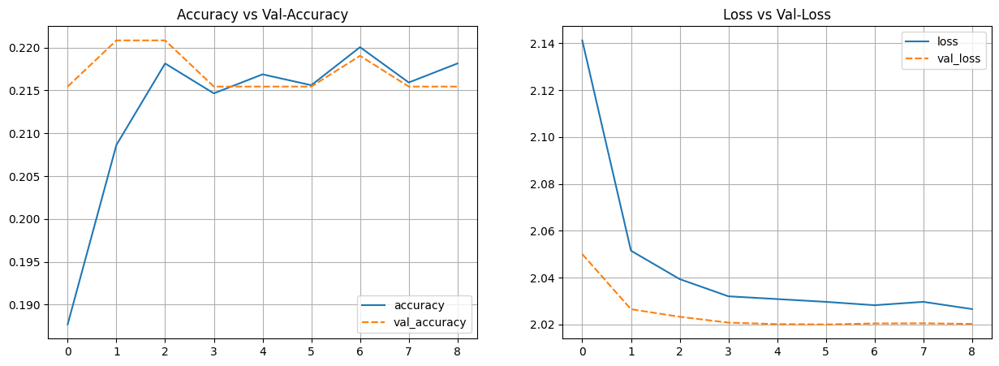

In [52]:
# create plots for training results

# create dataframe for training history
model_2_history_df = pd.DataFrame(history_2.history)

# create plot for accuracy
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.lineplot(data=model_2_history_df[['accuracy', 'val_accuracy']])
plt.grid()
plt.title('Accuracy vs Val-Accuracy')

# create plot for loss
plt.subplot(1, 2, 2)
sns.lineplot(data=model_2_history_df[['loss', 'val_loss']])
plt.grid()
plt.title('Loss vs Val-Loss')
plt.show()

***From the plots above, it can be seen that the model is an underfit.***

`Accuracy Plot`
- The accuracy values for both training and validation data are quite bad. Accuracy metric measures how much correct predictions the model made and has range of 0-1. Meanwhile, both training and validation data have accuracy score of around 0.2, which can be deemed as low.

`Loss Plot`
- Training and validation loss continues to decrease.
- The loss value for both training and validation data are quite high, both having loss value of around 2.

---
### 7.3.B. Test Set
Data scientist will use first model to make predictions using test set, and use the predictions to evaluate the model by comparing with the actual label.

In [53]:
# make prediction
# calculate probability
y_pred_test_2 = model_2.predict(x_test)
# take class with biggest probability
y_pred_test_2 = np.argmax(y_pred_test_2, axis=-1)

29/29 [==============================] - 2s 16ms/step


In [54]:
# prepare label for concat
## reset index
y_test_2 = y_test.reset_index(drop=True)
## insert to dataframe
y_test_2 = pd.DataFrame(y_test_2)

# prepare feature for concat
## reset index
x_test_2 = x_test.reset_index(drop=True)
## insert to dataframe
x_test_2 = pd.DataFrame(x_test_2)

# prepare prediction for concat
## reshape
y_pred_test_2 = y_pred_test_2.reshape(-1, 1)
## insert to dataframe
y_pred_test_2 = pd.DataFrame(y_pred_test_2)

# make evaluation table
model2_eval = pd.concat([x_test_2, y_test_2, y_pred_test_2], axis=1)
model2_eval = model2_eval.reset_index(drop=True)
model2_eval = model2_eval.rename(columns={0: 'prediction'})

# show evaluation table
model2_eval.head()

,text_processed,label,prediction
0,mina last appeared rhys adult woman seems reta...,0,4
1,crystal gregory beautiful new teacher sunnydal...,4,5
2,new york time bestselling queen twist returns…...,5,5
3,prince rupert taken roundhead ; held captive c...,0,5
4,coded message smuggled russia plea help supers...,5,5


In [55]:
# show classification report
print('Model 2 Classification Report (Test) : \n',classification_report(model2_eval['label'], model2_eval['prediction']))

Model 2 Classification Report (Test) : 
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       175
           1       0.00      0.00      0.00       129
           2       0.00      0.00      0.00       100
           3       0.00      0.00      0.00       120
           4       0.23      0.07      0.11       120
           5       0.23      0.99      0.37       205
           6       0.00      0.00      0.00        20
           7       0.00      0.00      0.00        22
           8       0.00      0.00      0.00        17
           9       0.00      0.00      0.00        20

    accuracy                           0.23       928
   macro avg       0.05      0.11      0.05       928
weighted avg       0.08      0.23      0.10       928



<Axes: >

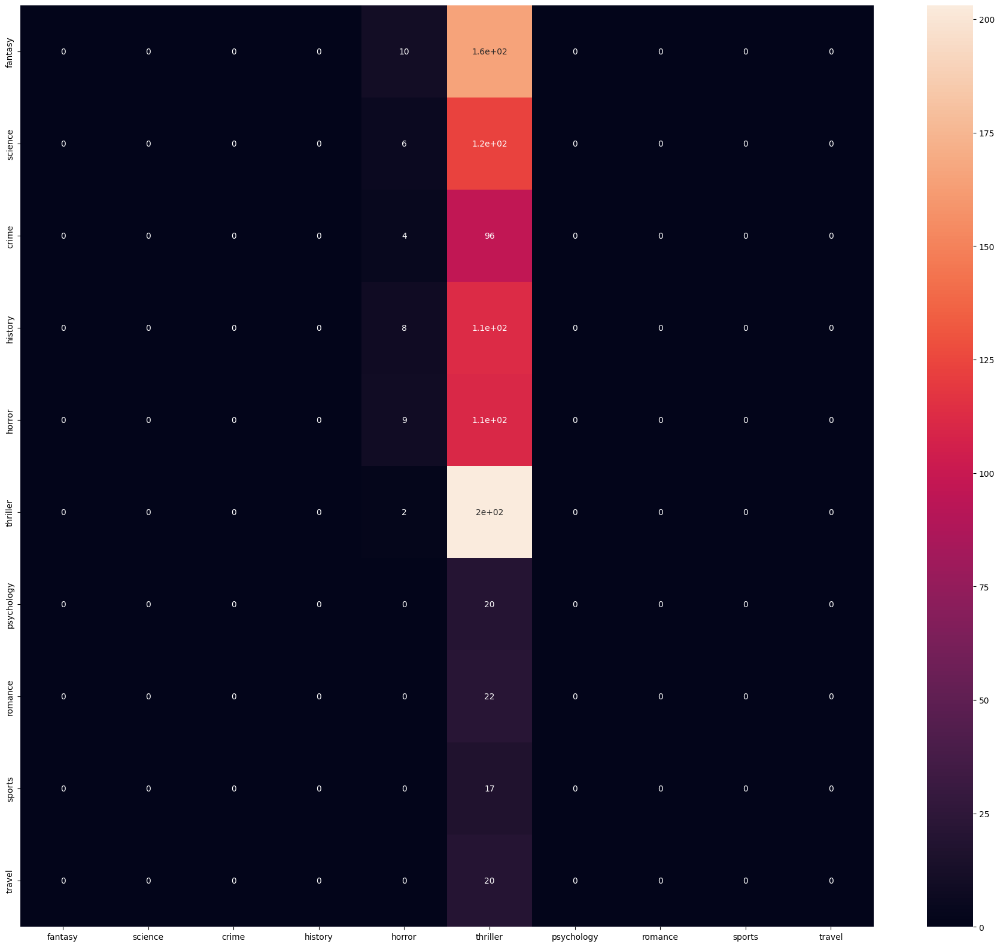

In [56]:
# show confusion matrix
np.set_printoptions(suppress=True)
plt.figure(figsize=(23, 20))
model1_confusionmatrix = confusion_matrix(model2_eval['label'], model2_eval['prediction'])
sns.heatmap(model1_confusionmatrix, annot=True , xticklabels=class_names, yticklabels=class_names)

In [57]:
# define incorrect predictions
incorrect_predictions_2 = model2_eval[model2_eval['label'] != model2_eval['prediction']]

# show incorrect predictions
incorrect_predictions_2.head()

,text_processed,label,prediction
0,mina last appeared rhys adult woman seems reta...,0,4
1,crystal gregory beautiful new teacher sunnydal...,4,5
3,prince rupert taken roundhead ; held captive c...,0,5
6,year claire randall former combat nurse back w...,0,5
8,book open world university toronto five main c...,0,5


In [58]:
# create looping for label and prediction
for i in ['label', 'prediction']:
  # count frequency of unique values in label and prediction
  print(incorrect_predictions_2[i].value_counts())
  print('')

label
0    175
1    129
3    120
4    111
2    100
7     22
6     20
9     20
8     17
5      2
Name: count, dtype: int64

prediction
5    686
4     30
Name: count, dtype: int64



From the results above, it can be understood that all genres except '5' or 'thriller' and '4' or 'horror' have 0 for the evaluation scores using all metrics. This shows that model can only predict data with genre 'thriller' and 'horror', and cannot predict other genres at all.

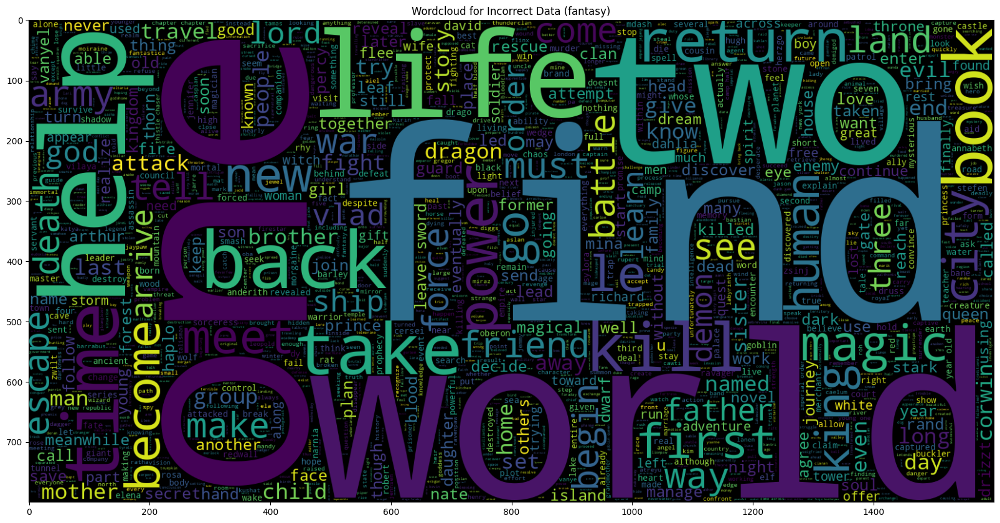

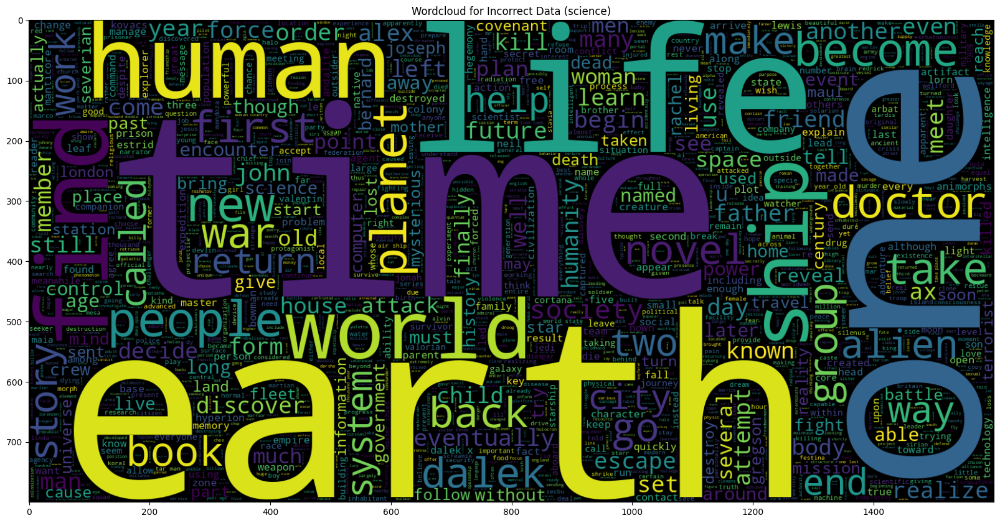

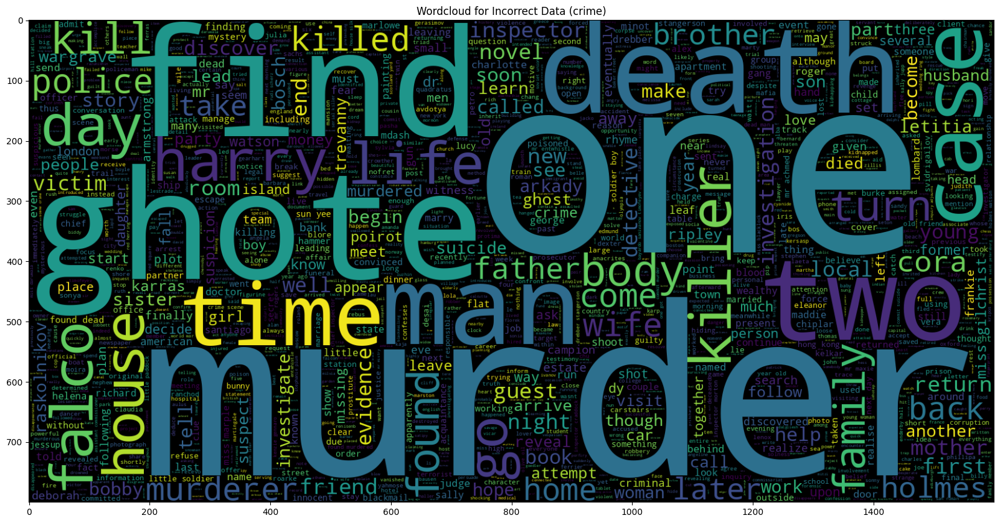

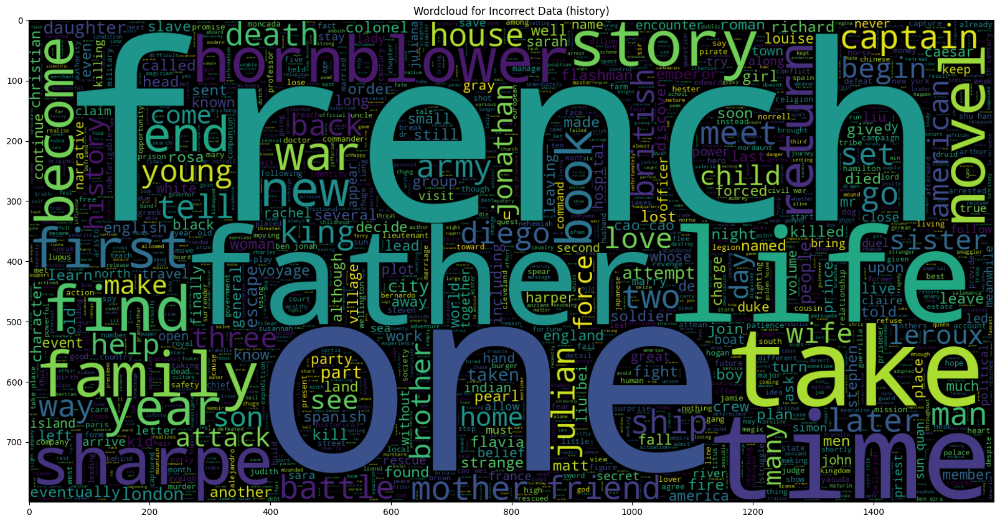

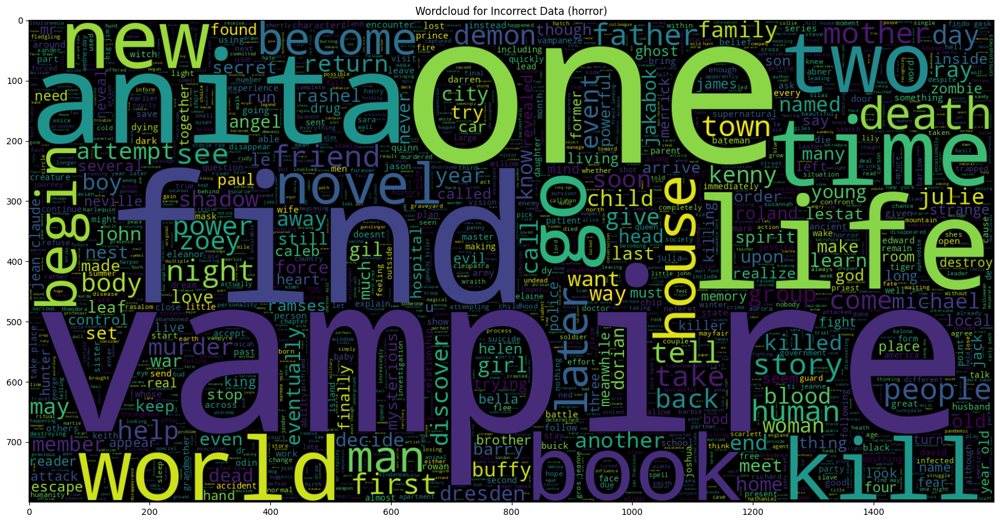

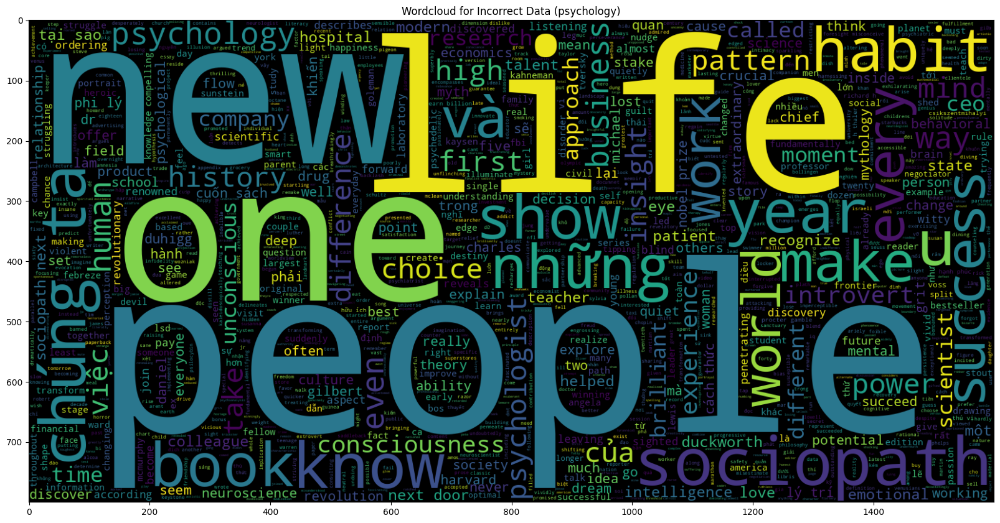

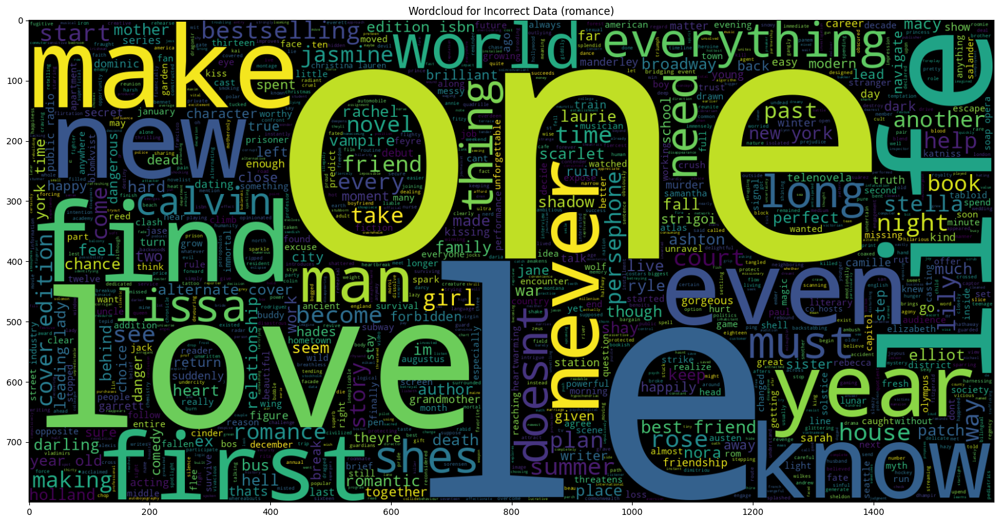

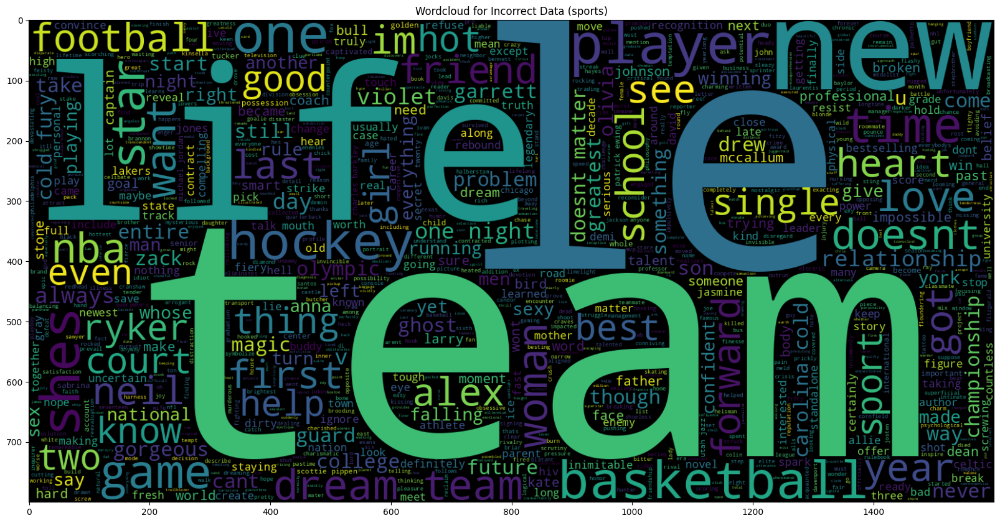

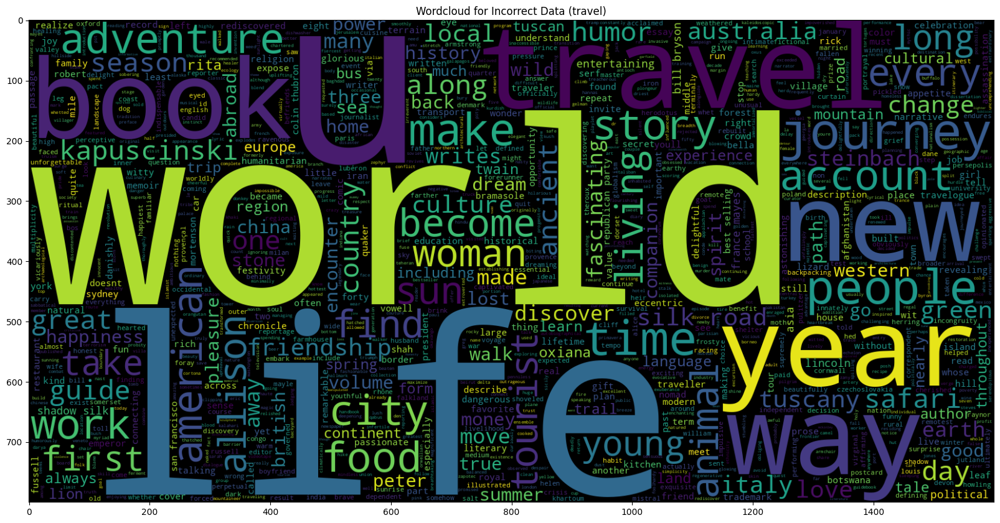

In [59]:
# show wordcloud for incorrect predictions
## create looping for all genres except thriller
for i in [0, 1, 2, 3, 4, 6, 7, 8, 9]:
  ## create wordcloud
  plt.figure(figsize = (20,20))
  wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(incorrect_predictions_2[incorrect_predictions_2.label == i].text_processed))
  plt.title(f'Wordcloud for Incorrect Data ({dict_class[i]})')
  plt.imshow(wc , interpolation = 'bilinear')

### 7.3.C. Model Strengths, Weaknesses, Improvement
`Strengths`
- Model can run properly.
- Model can predict genre 'thriller' well, and some data with genre 'horror'.

`Weaknesses`
- Model cannot predict other genres besides 'thriller' and 'horror'.
- Model has high loss score
- Model has low accuracy score, which means that there are many incorrect predictions.

`Improvement`
- This model has less incorrect predictions than the first model.
- This model is more of a good fit compared to the first model.

---
---

# 8. Model Saving

In [71]:
# show model summary
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 128)               112461824 
                                                                 
 reshape (Reshape)           (None, 128, 1)            0         
                                                                 
 lstm (LSTM)                 (None, 128, 256)          264192    
                                                                 
 dropout (Dropout)           (None, 128, 256)          0         
                                                                 
 lstm_1 (LSTM)               (None, 128, 128)          197120    
                                                                 
 dropout_1 (Dropout)         (None, 128, 128)          0         
                                                                 
 lstm_2 (LSTM)               (None, 128, 64)           4

In [72]:
# freeze model
model_2.trainable = False

In [73]:
# show model summary after freezing
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 128)               112461824 
                                                                 
 reshape (Reshape)           (None, 128, 1)            0         
                                                                 
 lstm (LSTM)                 (None, 128, 256)          264192    
                                                                 
 dropout (Dropout)           (None, 128, 256)          0         
                                                                 
 lstm_1 (LSTM)               (None, 128, 128)          197120    
                                                                 
 dropout_1 (Dropout)         (None, 128, 128)          0         
                                                                 
 lstm_2 (LSTM)               (None, 128, 64)           4

In [74]:
# save model to keras
model_2.save('model_2.h5')

In [66]:
# save preprocessing function
with open('preprocessor.pkl', 'wb') as file_1:
  pickle.dump(text_preprocessing, file_1)

---
---

# 9. Model Inference

Model Inference process is done in another file named `Book_Genre_Prediction_Inference_Celine_Clarissa.ipynb`.



---
---

# 10. Conclusion

As a conclusion, from the processes that has been done, some results have been obtained. Some models were successfully made. However, it was not possible to make a model with accuracy score of more than 90% within the deadline. In fact, data scientist does not recommend too use the model made, and advise to further improve model, because the model did not perform well during evaluation and can only predict certain genres. 

`Model Improvement`

To further improve model, data scientist recommends to:
- Try different models, such as machine learning models: SVC, Random Forest, Decision Tree, etc.
- Use diffreent parameters in model.